# Import & Configurations (No need to run)

In [ ]:
!apt-get install openjdk-8-jdk-headless -qq > /dev/null
!wget -O ./spark-3.3.2-bin-hadoop3.tgz  https://dlcdn.apache.org/spark/spark-3.3.2/spark-3.3.2-bin-hadoop3.tgz
!tar zxvf ./spark-3.3.2-bin-hadoop3.tgz
!pip install findspark

--2023-02-18 13:15:47--  https://dlcdn.apache.org/spark/spark-3.3.2/spark-3.3.2-bin-hadoop3.tgz
Resolving dlcdn.apache.org (dlcdn.apache.org)... 151.101.2.132, 2a04:4e42::644
Connecting to dlcdn.apache.org (dlcdn.apache.org)|151.101.2.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 299360284 (285M) [application/x-gzip]
Saving to: ‘./spark-3.3.2-bin-hadoop3.tgz’

./spark-3.3.2-bin-h 100%[===================>] 285.49M   114MB/s    in 2.5s    

2023-02-18 13:15:50 (114 MB/s) - ‘./spark-3.3.2-bin-hadoop3.tgz’ saved [299360284/299360284]

spark-3.3.2-bin-hadoop3/
spark-3.3.2-bin-hadoop3/LICENSE
spark-3.3.2-bin-hadoop3/NOTICE
spark-3.3.2-bin-hadoop3/R/
spark-3.3.2-bin-hadoop3/R/lib/
spark-3.3.2-bin-hadoop3/R/lib/SparkR/
spark-3.3.2-bin-hadoop3/R/lib/SparkR/DESCRIPTION
spark-3.3.2-bin-hadoop3/R/lib/SparkR/INDEX
spark-3.3.2-bin-hadoop3/R/lib/SparkR/Meta/
spark-3.3.2-bin-hadoop3/R/lib/SparkR/Meta/Rd.rds
spark-3.3.2-bin-hadoop3/R/lib/SparkR/Meta/features.rds
spark-3

In [ ]:
import os

os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.3.2-bin-hadoop3"

In [ ]:
# #setting up Kaggle
# !pip install kaggle
# import json

# !mkdir /root/.kaggle/
# # Installing the Kaggle package

# #Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
# api_token = {"username":"roeygadot","key":"3ed997fd41ba8e9bd4eedceab3522a7a"}

# # creating kaggle.json file with the personal API-Key details 
# # You can also put this file on your Google Drive

# with open('/root/.kaggle/kaggle.json', 'w') as file:
#   json.dump(api_token, file)
# !chmod 600 /root/.kaggle/kaggle.json

In [ ]:
import findspark
import random
findspark.init()

In [ ]:
# Other imports
import numpy as np
import pyspark
from pyspark.rdd import RDD
from pyspark import SparkContext

# Preprocessing/Loading the data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pathlib
from tqdm import tqdm

In [ ]:
path_to_data = "/content/drive/MyDrive/Big Data project/Data" # make sure that the data in your drive is mapped to this location

In [ ]:
pip install pyspark -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 281.4/281.4 MB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.7/199.7 KB 11.2 MB/s eta 0:00:00


In [ ]:
from pyspark.sql import SparkSession
from pyspark.sql import types
from pyspark.sql import functions as F
import pyspark 

# Create a SparkSession
spark = SparkSession.builder.getOrCreate()


In [ ]:


# def get_schema():
#     # Defines the Scheme 
#     # Field 1: Latitude in decimal degrees.
#     # Field 2: Longitude in decimal degrees.
#     # Field 3: All set to 0 for this dataset.
#     # Field 4: Altitude in feet (-777 if not valid).
#     # Field 5: Date - number of days (with fractional part) that have passed since 12/30/1899.
#     # Field 6: Date as a string.
#     # Field 7: Time as a string.
#     return types.StructType([
#         types.StructField("LAT", types.DoubleType()),
#         types.StructField("LON", types.DoubleType()),
#         types.StructField("ZERO_FIELD", types.IntegerType()),
#         types.StructField("ALT", types.DoubleType()),
#         types.StructField("DATE_DAYS", types.DoubleType()),
#         types.StructField("DATE_STR", types.StringType()),
#         types.StructField("TIME_STR", types.StringType()),
#     ])


# def load_rdd_single_user(csv_path:str,schema=None) -> pyspark.sql.dataframe.DataFrame:
#     """
#     Loads and parses a single user from our data: 
#      - loads the csv
#      - adds the  information from the file path
#      - removs the nan rows (which removes the first 6 rows of each file)
#      - adds timestamp
#      - removes rows without information  

#     Note: only works for a specific file of some user or the "Trajectory"
#     directory of the user. 
#     """

#     if schema is None:
#         schema = get_schema()

#     df = spark.read.csv(
#         csv_path,
#         schema=schema
#     )

#     # adds user_id
#     try:
#         user_id = csv_path.split("/")[6] # infering the user id
#         df = df.withColumn("USER_ID",F.lit(user_id))
#     except IndexError:
#         print("user id that should be in the fifth directory in the path was not detected. Probably means you are loading the whole dataset and not a single user")
#     # drops rows with null values in any of the fields 
#     df = df.na.drop()

#     # add timestamp
#     full_date_str_col = F.concat_ws(" ",df.DATE_STR,df.TIME_STR)
#     full_date_col = F.to_timestamp(full_date_str_col)
#     df = df.withColumn("TIMESTAMP",full_date_col)

#     # remove unneeded fields 
#     df = df.drop("ZERO_FIELD")
#     df = df.drop("DATE_STR")
#     df = df.drop("TIME_STR")
#     return df

# # check that stuff works for a single file
# df_single_file = load_rdd_single_user(
#     "/content/drive/MyDrive/Big Data project/Data/000/Trajectory/20081023025304.plt",
# )
# df_single_file.show(5)

In [ ]:
# type(df_single_file)

In [ ]:
# type(df_single_file.rdd)

In [ ]:
# load_rdd_single_user("/content/drive/MyDrive/Big Data project/Data/000/Trajectory").show()

In [ ]:
# user_directories = sorted(pathlib.Path(path_to_data).glob("*/Trajectory"))
# data_for_user_5 = load_rdd_single_user(str(user_directories[5])) # 6th user because we start form 0
# data_for_user_5.show()

In [ ]:
# len(user_directories)

In [ ]:
# # loading the full dataset (and preprocessing it) 
# def load_rdd_all_user(
#     dir_path:str=path_to_data,schema=None
# ) -> pyspark.sql.dataframe.DataFrame:
#     if schema is None:
#         schema=get_schema()
#     res_rdd = None
#     user_directories = sorted(pathlib.Path(dir_path).glob("*/Trajectory"))
#     for csv_path in tqdm(user_directories):  
#         rdd_part = load_rdd_single_user(str(csv_path),schema) 
#         if res_rdd is None: # for the first user
#             res_rdd = rdd_part
#         else:
#             res_rdd = res_rdd.union(rdd_part)
#     return res_rdd

# # not using because the user id gets lost this way 
# # df = spark.read.csv(path_to_data, schema=schema)

# df = load_rdd_all_user() # takes some time (few minutes)

In [ ]:
# df.show(5)

In [ ]:
# df = df.orderBy("TIMESTAMP")

In [ ]:
# df.rdd

In [ ]:
# ls -lh /content/sample_data

In [ ]:
# # Saving preprocessed data to parquet files so that loading will be faster
# path_to_data_parquet = "/content/drive/MyDrive/Big Data project/Data" + ".parquet"

# df.write.partitionBy("USER_ID").mode("overwrite").parquet(path_to_data_parquet)


In [ ]:
df = spark.read.parquet("/content/drive/MyDrive/Big Data project/Data.parquet")

In [ ]:
df.show(5)

+---------+----------+-----+----------------+-------------------+-------+
|      LAT|       LON|  ALT|       DATE_DAYS|          TIMESTAMP|USER_ID|
+---------+----------+-----+----------------+-------------------+-------+
|39.986816|116.453741|507.0|40148.6009722222|2009-12-01 14:25:24|    153|
|25.285352|110.301668|394.0|40535.3602430556|2010-12-23 08:38:45|    153|
|39.986828|116.453708|507.0|40148.6010300926|2009-12-01 14:25:29|    153|
|25.285375|110.301663|397.0|40535.3603009259|2010-12-23 08:38:50|    153|
|39.986833|116.453693|507.0| 40148.601087963|2009-12-01 14:25:34|    153|
+---------+----------+-----+----------------+-------------------+-------+
only showing top 5 rows



In [ ]:
df.select('LAT','LON','ALT')

DataFrame[LAT: double, LON: double, ALT: double]

# Apply some distributed algorithms 

In [ ]:
from pyspark.sql.functions import col, to_date, to_timestamp, hour, minute
def get_time_frame(df, start_time, end_time):
  return df.withColumn('TIMESTAMP', to_timestamp(col('TIMESTAMP'), 'yyyy-MM-dd HH:mm:ss')).where(hour(col('TIMESTAMP')).between(start_time, end_time))

In [ ]:
# define times of day. Note that it includes end (6, 11) will give times from 6  to 11:59
morning = (6, 11)
noon = (12, 18)
evening = (19, 23)
night = (0, 5)

In [ ]:
from dataclasses import dataclass

@dataclass
class Section:
  left: float
  right: float 
  bottom: float
  top: float
# get lat and lon values borders for beijing
MAIN_LEFT = 116.021694
MAIN_RIGHT =  116.788841
MAIN_BOTTOM = 39.721549
MAIN_TOP = 40.178974

NUM_SECTIONS = 10
total_beijing_section = Section(MAIN_LEFT, MAIN_RIGHT, MAIN_BOTTOM, MAIN_TOP)
#Build Sections

lat_section_size = (total_beijing_section.top - total_beijing_section.bottom) / NUM_SECTIONS
lon_section_size = (total_beijing_section.right - total_beijing_section.left) / NUM_SECTIONS
base_lat = total_beijing_section.bottom
base_lon = total_beijing_section.left

sections = []
for i in range(NUM_SECTIONS):
  for j in range(NUM_SECTIONS):
    sections.append(Section(
        j * lon_section_size + base_lon,
        (j + 1) * lon_section_size + base_lon,
        i * lat_section_size + base_lat,
        (i + 1) * lat_section_size + base_lat
    ))
test_section = sections[int(len(sections)/2)]
print(test_section)
from pyspark.sql.dataframe import DataFrame

def select_section(df: DataFrame, section: Section) -> DataFrame:
  return df.filter(df.LAT.between(section.bottom, section.top) & df.LON.between(section.left, section.right))

In [ ]:
# test_df = select_section(df, test_section)

In [ ]:
total_beijing_df = select_section(df, total_beijing_section)

In [ ]:
time_dfs = {
  'morning' : get_time_frame(total_beijing_df, morning[0], morning[1]),
  'noon' : get_time_frame(total_beijing_df, noon[0], noon[1]),
  'evening' : get_time_frame(total_beijing_df, evening[0], evening[1]),
  'night' : get_time_frame(total_beijing_df, night[0], night[1]),
}

In [ ]:
# test_df.show()

In [ ]:
# from pyspark.ml.feature import VectorAssembler
# assembler = VectorAssembler(inputCols=['LAT', 'LON'], outputCol='features', handleInvalid="keep")
# test_df = assembler.transform(test_df)

In [ ]:
# from pyspark.ml.feature import VectorAssembler
# assembler = VectorAssembler(inputCols=['LAT', 'LON'], outputCol='features', handleInvalid="keep")
# total_beijing_df = assembler.transform(total_beijing_df)

In [ ]:
# from pyspark.ml.clustering import KMeans
# kmeans_val = KMeans(k=2, seed=1)
# model = kmeans_val.fit(test_df)

In [ ]:
# model.clusterCenters

In [ ]:
# model.clusterCenters()

In [ ]:
from pyspark.ml.clustering import KMeans, BisectingKMeans
from enum import Enum
from pyspark.ml.feature import VectorAssembler
def run_clustering(df, k: int, kmeans: bool):
  
  assembler = VectorAssembler(inputCols=['LAT', 'LON'], outputCol='features', handleInvalid="keep")
  tmp_df = assembler.transform(df)
  if kmeans:
    return KMeans(k=k).fit(tmp_df)
  else:
    # bisecting Kmeans
    return BisectingKMeans(k=k, minDivisibleClusterSize=100, maxIter=15).fit(tmp_df)


In [ ]:
# # run without time sectioning
# #regular kmeans
# kmeans_no_time = run_clustering(total_beijing_df, 100, True)
# pd.DataFrame(kmeans_no_time.clusterCenters(), columns=['latitude', 'longitude']).to_csv('/content/drive/MyDrive/Big Data project/kmeans_no_time.csv')

In [ ]:
# import pandas as pd
# #bisecting kmeans
# bisecting_kmeans_no_time = run_clustering(total_beijing_df, 100, False)
# pd.DataFrame(bisecting_kmeans_no_time.clusterCenters(), columns=['latitude', 'longitude']).to_csv('/content/drive/MyDrive/Big Data project/bisecting_kmeans_no_time.csv')

In [ ]:
# import pandas as pd
# # kmeans on all times
# for time, time_df in time_dfs.items():
#   kmeans_time = run_clustering(time_df, 100, True)
#   pd.DataFrame(kmeans_time.clusterCenters(), columns=['latitude', 'longitude']).to_csv(f'/content/drive/MyDrive/Big Data project/kmeans_{time}.csv')

In [ ]:
import pandas as pd
# bisecting kmeans on all times
for time, time_df in time_dfs.items():
  bisecting_kmeans_time = run_clustering(time_df, 100, False)
  pd.DataFrame(bisecting_kmeans_time.clusterCenters(), columns=['latitude', 'longitude']).to_csv(f'/content/drive/MyDrive/Big Data project/bisecting_kmeans_{time}_100.csv')

In [ ]:
# from pyspark.ml.clustering import KMeans, BisectingKMeans
# kmeans_val2 = KMeans(k=100, seed=1)
# model2 = kmeans_val2.fit(total_beijing_df)

In [ ]:
# kmeans_val2 = KMeans(k=18, seed=1)
# model2 = kmeans_val2.fit(test_df)

In [ ]:
# import pandas as pd
# centers_df = pd.DataFrame(model2.clusterCenters(), columns=['latitude', 'longitude'])

In [ ]:
# centers_df

,latitude,longitude
0,39.980285,116.361377
1,39.915720,116.671429
2,39.891509,116.379127
3,39.925202,116.467222
4,40.098513,116.102037
5,40.119694,116.257042
6,39.794305,116.315728
7,39.985745,116.214002
8,39.985568,116.319629
9,40.127974,116.476402


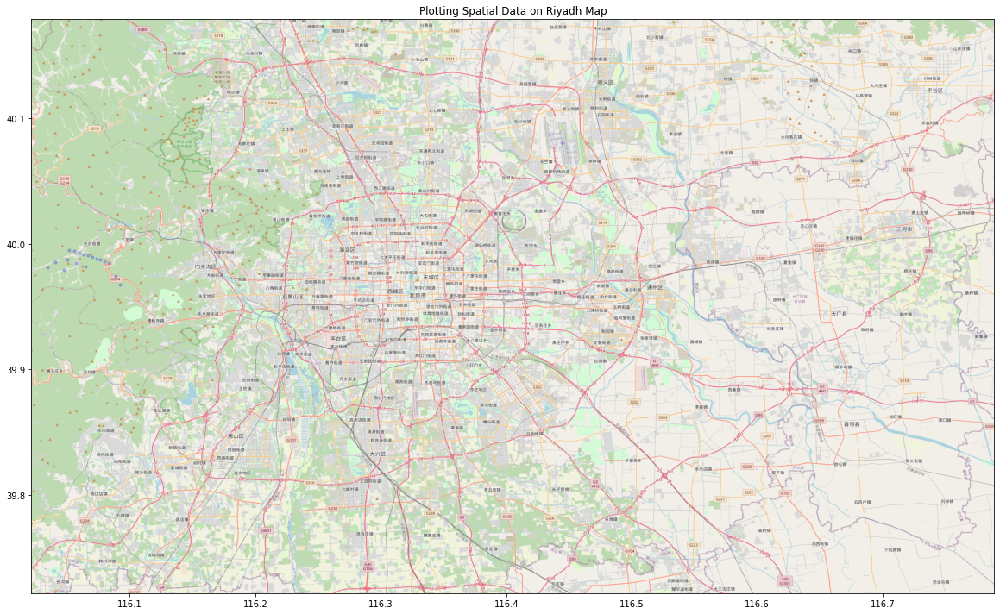

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

ruh_m = plt.imread('/content/drive/MyDrive/Big Data project/map.png')

BBox = (total_beijing_section.left,   total_beijing_section.right,      
         total_beijing_section.bottom, total_beijing_section.top)

# test_data = {
#   "latitude": [39.916027, 39.900274],
#   "longitude": [116.397180, 116.397832]
# }

# map_df = pd.DataFrame(test_data)


fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(centers_df.longitude, centers_df.latitude, zorder=1, alpha= 0.2, c='b', s=10)
ax.set_title('Plotting Spatial Data on Riyadh Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(ruh_m, zorder=0, extent = BBox, aspect= 'equal')


In [ ]:
# # TODO LIST 
# - categorize by Timestamp and cluster each category  
# - plot heatmaps - plotly
# - alternative clustering algorithms - bisecting k-means
# - run 4 times (for each algorithm, with and without time of day sectioning)
# - qualitative analysis - compare result clusters to certain known pois
# - write final paper (create required images and graphs during work)


# TODO LIST 
- ~check that the amount of data in the beijing section is big enough~
- ~plot heatmaps - plotly~
- ~run 4 times (for each algorithm, with and without time of day sec~
- ~quantitive analysis - compare using clustering comparison tools~
- ~heatmap with all/most of the users~ - impossible (maybe we can do that for a small sample per user. Like no more than 1k measurement for each)
- use alternative clustering algorithms - bisecting k-means - use less clusters
- write final paper (create required images and graphs during work)
  - introduction
  - experiments
  - results
  - conclusions
- upload to github repository

# Comparison of user 0 trajectory to kmeans clustering

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import pandas as pd
import plotly.graph_objects as go

kmeans_no_time=pd.read_csv('/content/drive/MyDrive/Big Data project/kmeans_no_time.csv').assign(name="kmeans_no_time")
kmeans_morning=pd.read_csv('/content/drive/MyDrive/Big Data project/kmeans_morning.csv').assign(name="kmeans_morning")
kmeans_evening=pd.read_csv('/content/drive/MyDrive/Big Data project/kmeans_evening.csv').assign(name="kmeans_evening")
kmeans_night=pd.read_csv('/content/drive/MyDrive/Big Data project/kmeans_night.csv').assign(name="kmeans_night")
kmeans_noon=pd.read_csv('/content/drive/MyDrive/Big Data project/kmeans_noon.csv').assign(name="kmeans_noon")

df=pd.read_parquet(
    '/content/drive/MyDrive/Big Data project/Data.parquet',
    filters=[[('USER_ID','==',0)]],
    use_legacy_dataset=True
)


Mounted at /content/drive


/usr/local/lib/python3.8/dist-packages/pandas/io/parquet.py:239: FutureWarning: Passing 'use_legacy_dataset=True' to get the legacy behaviour is deprecated as of pyarrow 8.0.0, and the legacy implementation will be removed in a future version.
  result = self.api.parquet.read_table(


In [ ]:
user_0_data = go.Densitymapbox(lat=df.LAT, lon=df.LON, z=df.assign(Z=1).Z,radius=1)

In [ ]:
get_go = lambda df: go.Scattermapbox(lat=df.latitude, lon=df.longitude,marker=dict(size=10),name=df.name.iloc[0])
go_kmeans_no_time = get_go(kmeans_no_time)
go_kmeans_morning = get_go(kmeans_morning)
go_kmeans_evening = get_go(kmeans_evening)
go_kmeans_night = get_go(kmeans_night)
go_kmeans_noon = get_go(kmeans_noon)
go_kmeans_yes_time = get_go(pd.concat([kmeans_morning,kmeans_evening,kmeans_night,kmeans_noon]))

In [ ]:

fig = go.Figure([
  # user_0_data,
  go_kmeans_no_time,
  # go_kmeans_yes_time,
  go_kmeans_morning,
  go_kmeans_evening,
  go_kmeans_night,
  go_kmeans_noon,
])
fig.update_layout(mapbox_style="stamen-terrain", mapbox_center_lon=116.31,mapbox_center_lat=40)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
# fig.update_coloraxes(showscale=False)
# fig.update_traces(showscale=False)
fig.update_layout(coloraxis_showscale=False)
fig.show()

In [ ]:
import plotly.graph_objects as go
import pandas as pd
def heatmap_for_df(df,z=1): 
    """
    z controls how bright each dot is (heat amount). 
    df should contain LAT and LON

    doesn't work well for plotting the center...

    To plot both centers and heatmap we can use (I think):
    go.Figure([
      go.Densitymapbox(lat=df.LAT, lon=df.LON, z=df.assign(Z=z).Z,radius=1)),
      go.Scattermapbox(lat=df_centers.LAT, lon=df_centers.LON),
    ]
    fig.update_layout(mapbox_style="stamen-terrain", mapbox_center_lon=116.31,mapbox_center_lat=40)
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    """
    fig = go.Figure(go.Densitymapbox(lat=df.LAT, lon=df.LON, z=df.assign(Z=z).Z,
                                     radius=1))
    fig.update_layout(mapbox_style="stamen-terrain", mapbox_center_lon=116.31,mapbox_center_lat=40)
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    return fig


In [ ]:

some_centers = pd.DataFrame([
{"LAT":39.967277,"LON":116.092199},
{"LAT":39.981394,"LON":116.034541},
{"LAT":39.992663,"LON":116.059925},
{"LAT":39.987452,"LON":116.049999},
{"LAT":39.987268,"LON":116.076583},
{"LAT":39.981984,"LON":116.064661},
{"LAT":39.985376,"LON":116.040685},
{"LAT":39.984859,"LON":116.083432},
{"LAT":39.995321,"LON":116.051632},
{"LAT":39.990584,"LON":116.066441},
{"LAT":39.974194,"LON":116.088775},
{"LAT":39.988348,"LON":116.073401},
{"LAT":39.993996,"LON":116.056024},
{"LAT":39.979428,"LON":116.047220},
{"LAT":39.989513,"LON":116.069892},
{"LAT":39.991566,"LON":116.063433},
{"LAT":39.984436,"LON":116.056918},
{"LAT":39.986317,"LON":116.079645},
])

heatmap_for_df(some_centers)

# Result evaluation

In [ ]:
from sklearn.metrics.pairwise import euclidean_distances
import numpy as np

In [ ]:
qulitative=pd.read_csv('/content/drive/MyDrive/Big Data project/qulitative.csv')
standard_center = np.array(qulitative[["latitude","longitude"]])

In [ ]:
# kmeans
dtt = pd.DataFrame(columns=["time","mean"])
dtt["time"] = ["kmeans_no_time","kmeans_morning","kmeans_noon","kmeans_evening","kmeans_night"]
test = []

pre_center = np.array(kmeans_no_time[["latitude","longitude"]])
i = euclidean_distances(pre_center, standard_center).min(axis=0).mean()
test.append(i)
pre_center = np.array(kmeans_morning[["latitude","longitude"]])
i = euclidean_distances(pre_center, standard_center).min(axis=0).mean()
test.append(i)
pre_center = np.array(kmeans_noon[["latitude","longitude"]])
i = euclidean_distances(pre_center, standard_center).min(axis=0).mean()
test.append(i)
pre_center = np.array(kmeans_evening[["latitude","longitude"]])
i = euclidean_distances(pre_center, standard_center).min(axis=0).mean()
test.append(i)
pre_center = np.array(kmeans_night[["latitude","longitude"]])
i = euclidean_distances(pre_center, standard_center).min(axis=0).mean()
test.append(i)

dtt["mean"] = test
dtt

,time,mean
0,kmeans_no_time,0.010886
1,kmeans_morning,0.010737
2,kmeans_noon,0.011262
3,kmeans_evening,0.013087
4,kmeans_night,0.013197


# Kaggle dataset analysis (kepts for pyspark examples)

You can choose whatever data set you like from Kaggle and you need to derive meanigful insights using the Pyspark Dataframe API.
You need to use all the following methods at least one time [DataFrame API](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.html#pyspark.sql.DataFrame):

*   [show](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.show.html#pyspark.sql.DataFrame.show)
*   [printSchema](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.printSchema.html#pyspark.sql.DataFrame.printSchema)
*   [distinct](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.distinct.html#pyspark.sql.DataFrame.distinct)
*   [filter](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.filter.html#pyspark.sql.DataFrame.filter)
*   [foreach](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.foreach.html#pyspark.sql.DataFrame.foreach)
*   [join](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.join.html#pyspark.sql.DataFrame.join)
*   [orderBy](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.orderBy.html#pyspark.sql.DataFrame.orderBy)
*   [sample](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.sample.html#pyspark.sql.DataFrame.sample)
*   [select](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.select.html#pyspark.sql.DataFrame.select)
*   [subtract](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.subtract.html#pyspark.sql.DataFrame.subtract)
*   [where](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.where.html#pyspark.sql.DataFrame.where)
*   [withColumn](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.withColumn.html#pyspark.sql.DataFrame.withColumn)
*   [withColumnRenamed](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.DataFrame.withColumnRenamed.html#pyspark.sql.DataFrame.withColumnRenamed)

In addition, use at least one of the given [functions](https://spark.apache.org/docs/3.1.1/api/python/reference/pyspark.sql.html#functions):
*   [array_contains](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.functions.array_contains.html#pyspark.sql.functions.array_contains)
*   [avg](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.functions.avg.html#pyspark.sql.functions.avg)
*   [collect_set](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.functions.collect_set.html#pyspark.sql.functions.collect_set)
*   [countDistinct](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.functions.countDistinct.html#pyspark.sql.functions.countDistinct)
*   [datediff](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.functions.datediff.html#pyspark.sql.functions.datediff)
*   [min](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.functions.min.html#pyspark.sql.functions.min)
*   [regexp_extract](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.functions.regexp_extract.html#pyspark.sql.functions.regexp_extract)
*   [window](https://spark.apache.org/docs/3.1.1/api/python/reference/api/pyspark.sql.functions.window.html?highlight=window)





In [ ]:
# !kaggle datasets download -d devrimtuner/top-100-video-games

In [ ]:
# !unzip top-100-video-games

In [ ]:
# from pyspark.sql import SparkSession
# from pyspark.sql.functions import split, cast, col, regexp_replace, to_date
# from pyspark.sql.types import DateType, IntegerType

# # Create a SparkSession
# spark = SparkSession.builder.getOrCreate()

# # Read the dataset into an RDD
# df = spark.read.csv('/content/List of best-selling video games.csv', header=True)

In [ ]:
# import calendar
# from pyspark.sql.functions import udf
# def parse_date(date: str):
#   months_dict = {month: index for index, month in enumerate(calendar.month_name) if month}
#   parts = date.split(' ')
#   # Month_name day, year format
#   if len(parts) > 1:
#     month = months_dict[parts[0]]
#     day = parts[1].split(',')[0]
#     year = parts[2]
#   # day.Month_name.short_year foramt
#   else:
#     # print(date)
#     parts = date.split('.')
#     month = months_dict[parts[1]]
#     day = parts[0]
#     year = f'20{parts[2]}' if int(parts[2]) < 22 else f'19{parts[2]}'
#   return f'{day}/{month}/{year}'
# parse_date_udf = udf(parse_date)
# df = df.withColumn('Initial release date', split(col('Initial release date'), '\[').getItem(0))
# df = df.withColumn('Initial release date', parse_date_udf(col('Initial release date')))

In [ ]:
# df = df.withColumn('Rank', split(col('Rank'), '\.').getItem(0))
# df = df.withColumn('Sales', split(col('Sales'), '\[').getItem(0))
# df = df.withColumn('Platform(s)', split(col('Platform(s)'), '\[').getItem(0))
# df = df.withColumn('Sales', regexp_replace(col('Sales'), ',', ''))

# df = df.withColumn("Rank",df.Rank.cast('integer'))
# df = df.withColumn("Sales",df.Sales.cast(IntegerType()))
# # df = df.withColumn("Initial release date", to_date(df["Initial release date"],'M/dd/yyyy'))


In [ ]:
# df.show()

In [ ]:
# df.printSchema()

In [ ]:
# # Count the number of distinct developers, publishers, and platforms
# num_developers = df.select('Developer(s)[a]').distinct().count()
# num_publishers = df.select('Publisher(s)[a]').distinct().count()
# num_platforms = df.select('Platform(s)').distinct().count()
# print(f'Number of distinct developers: {num_developers}')
# print(f'Number of distinct publishers: {num_publishers}')
# print(f'Number of distinct platforms: {num_platforms}')

In [ ]:
# #show only games that had over 50M sales
# filtered_df = df.filter(df['Sales'] > 50000000).show()

In [ ]:
# # generate mock df with review scores to join

# df2 = spark.createDataFrame([(i, random.uniform(70,99)) for i in range(1, 51)], ['Rank', 'Score'])
# df2.show()

In [ ]:
# #join tables
# joined_df = df.join(df2, on='Rank')
# joined_df.show()

In [ ]:
# # sort from highest to lowest scoring games
# # NOTE: sales that have null values are due to missing data
# sorted_df = joined_df.orderBy(joined_df['Score'].desc())
# sorted_df.show()

In [ ]:
# # show all the distinct developers
# platforms = df.select('Developer(s)[a]').distinct()
# platforms.show()

In [ ]:
# # show all games published by nintendo
# df3 = df.where(df["Publisher(s)[a]"] == 'Nintendo')
# df3.show(500)

In [ ]:
# #use subtract to show all games which were not published by nintendo
# df.subtract(df3).show(500)

In [ ]:
# #get 10% of the data
# df.sample(False, 0.1).show()

In [ ]:
# sales_df = df.select(df['Title'], df['Sales'])
# sales_df = sales_df.withColumnRenamed('Sales', 'Total Sales')
# sales_df.show()

In [ ]:

# df.show()

In [ ]:
# # count rows in df
# acc=spark.sparkContext.accumulator(0)
# df.foreach(lambda x:acc.add(1))
# acc

In [ ]:
# # calculate average sales for a successful video game
# df.select(pyspark.sql.functions.avg("Sales")).collect()

In [ ]:
# # Count distinct developer(s) publisher combinations 
# df.agg(pyspark.sql.functions.countDistinct("Developer(s)[a]","Publisher(s)[a]").alias('c')).collect()

In [ ]:
# df.dtypes

In [ ]:
# 

# unsued section implementation

In [ ]:
# from dataclasses import dataclass

# @dataclass
# class Section:
#   bottom_left: tuple
#   top_left: tuple 
#   bottom_right: tuple
#   top_right: tuple

In [ ]:
# # get lat and lon values borders for beijing
# BOTTOM_RIGHT = (39.721549, 116.788841)
# TOP_RIGHT = (40.178974, 116.788841)
# TOP_LEFT = (40.178974, 116.021694)
# BOTTOM_LEFT = (39.721549, 116.021694)

# NUM_SECTIONS = 10

In [ ]:
# total_beijing_section = Section(BOTTOM_LEFT, TOP_LEFT, BOTTOM_RIGHT, TOP_RIGHT)

In [ ]:
# #Build Sections

# lat_section_size = (TOP_LEFT[0] - BOTTOM_LEFT[0]) / NUM_SECTIONS
# lon_section_size = (BOTTOM_RIGHT[1] - BOTTOM_LEFT[1]) / NUM_SECTIONS
# base_lat = BOTTOM_LEFT[0]
# base_lon = BOTTOM_LEFT[1]

# sections = []
# for i in range(NUM_SECTIONS):
#   for j in range(NUM_SECTIONS):
#     sections.append(Section(
#         (i * lat_section_size + base_lat, j * lon_section_size + base_lon),
#         ((i + 1) * lat_section_size + base_lat, j * lon_section_size + base_lon),
#         (i * lat_section_size + base_lat, (j + 1) * lon_section_size + base_lon),
#         ((i + 1) * lat_section_size + base_lat, (j + 1) * lon_section_size + base_lon)
#     ))